In [1]:
import os
import random

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

from skimage.io import imread

from tensorflow import keras
import tensorflow as tf

In [2]:
plt.rcParams["figure.figsize"] = (16,7)

In [3]:
#path to data
TRAIN_FOLDER = 'data/train_v2/'
TEST_FOLDER = 'data/test_v2/'

#random seed
RANDOM_SEED = 42

# train_ship_segmentations_v2

In [4]:
#masks of ships per image
df = pd.read_csv('data/train_ship_segmentations_v2.csv')

display(df.head())
df.info()

,ImageId,EncodedPixels
0,00003e153.jpg,NaN
1,0001124c7.jpg,NaN
2,000155de5.jpg,264661 17 265429 33 266197 33 266965 33 267733...
3,000194a2d.jpg,360486 1 361252 4 362019 5 362785 8 363552 10 ...
4,000194a2d.jpg,51834 9 52602 9 53370 9 54138 9 54906 9 55674 ...


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 231723 entries, 0 to 231722
Data columns (total 2 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   ImageId        231723 non-null  object
 1   EncodedPixels  81723 non-null   object
dtypes: object(2)
memory usage: 3.5+ MB


In [5]:
#number of unique images
print('Number of unique images: ', len(os.listdir(TRAIN_FOLDER)))
print('Number of images with target: ', df.shape[0])

Number of unique images:  192556
Number of images with target:  231723


,count,proportion
Num_of_ships,,
0,150000,0.778994
1,27104,0.140759
2,7674,0.039853
3,2954,0.015341
4,1622,0.008424
5,925,0.004804
6,657,0.003412
7,406,0.002108
8,318,0.001651


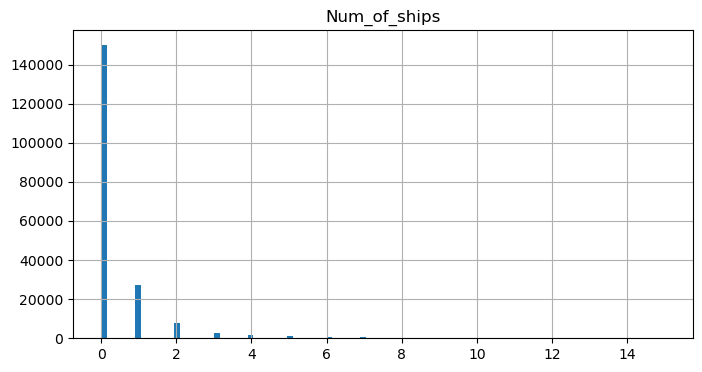

In [6]:
#So some image contains more than one ship

num_of_ships = df.groupby('ImageId')['EncodedPixels'].count().rename("Num_of_ships").reset_index()

display(
num_of_ships['Num_of_ships'].value_counts().to_frame()\
.join(num_of_ships['Num_of_ships'].value_counts(normalize=True)))

num_of_ships[['Num_of_ships']].hist(bins=100, figsize=(8, 4))
plt.show()

As we can see, there is a huge disbalance in our data. 150000 of images (78%) don't contain any ship. So we should keep it in mind, to solve this task more properly. We will use "train_test_split" with **stratify = num_of_ships**. Also we will use data augmentaion only for images with ships.

***

# Some plots

In [7]:
print('Image shape: ', plt.imread(os.path.join(TRAIN_FOLDER, num_of_ships.iloc[0,0])).shape)

Image shape:  (768, 768, 3)


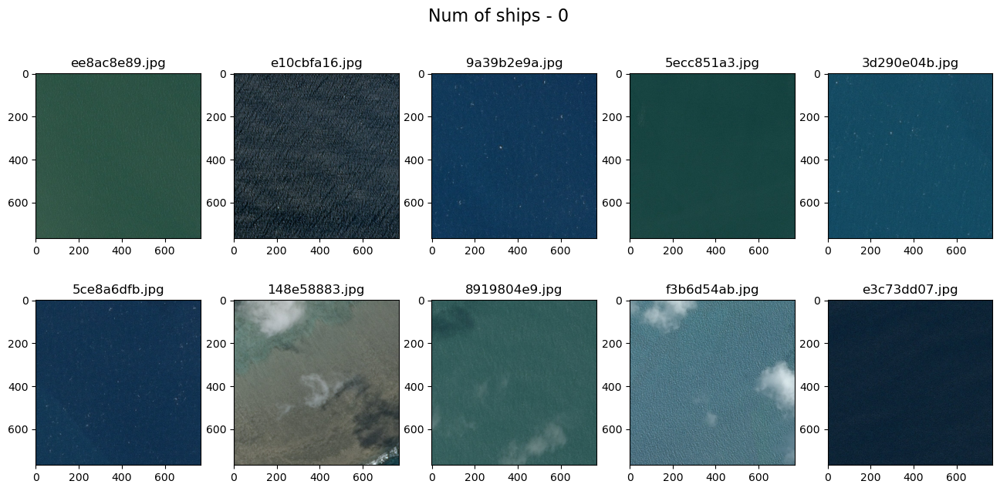

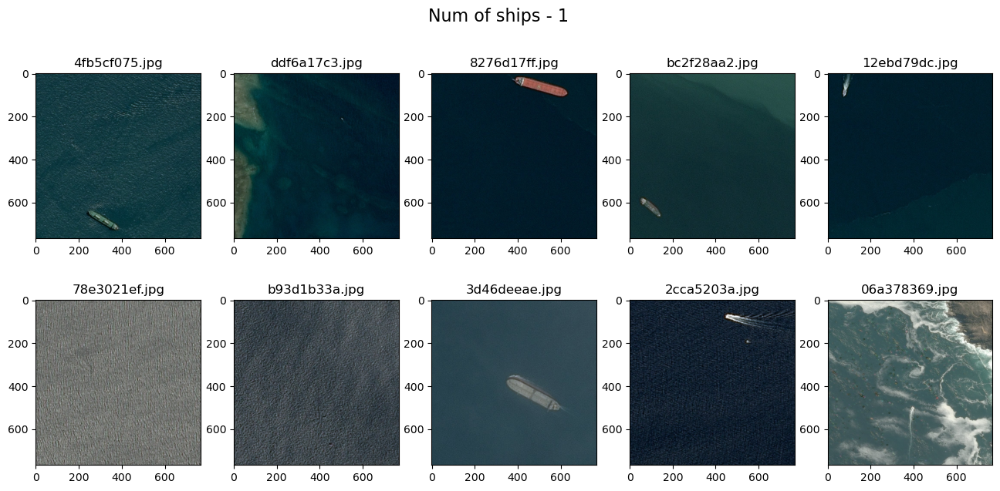

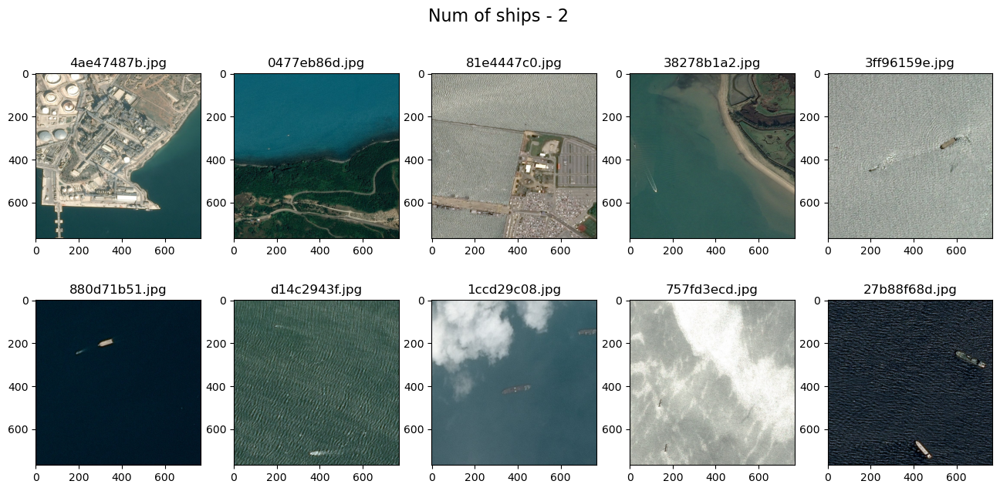

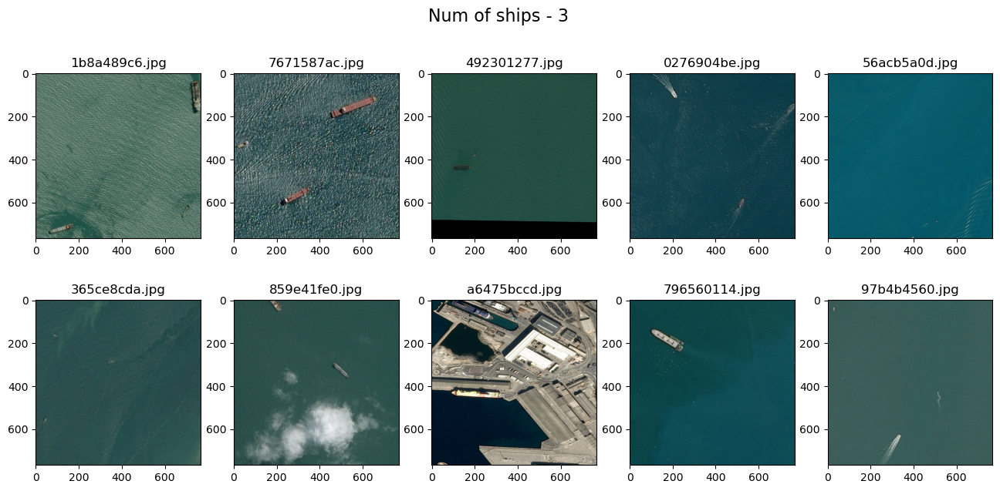

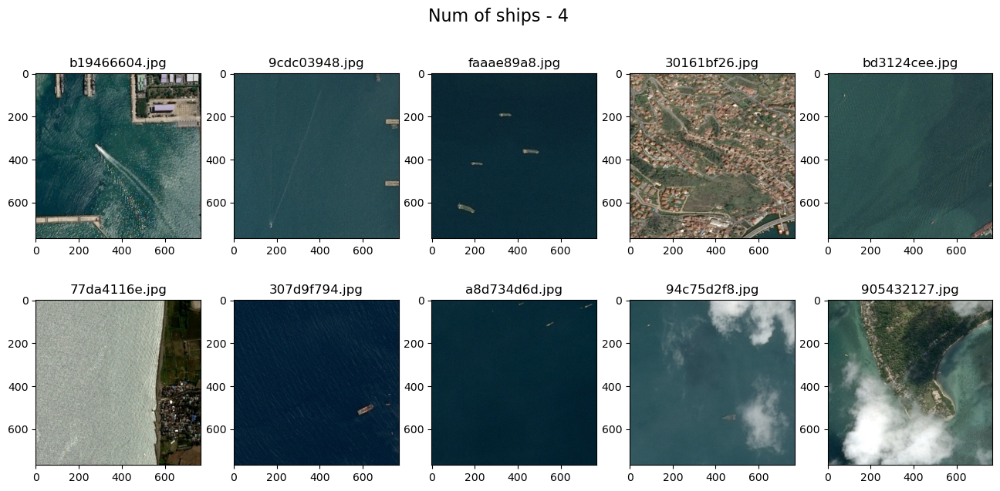

...

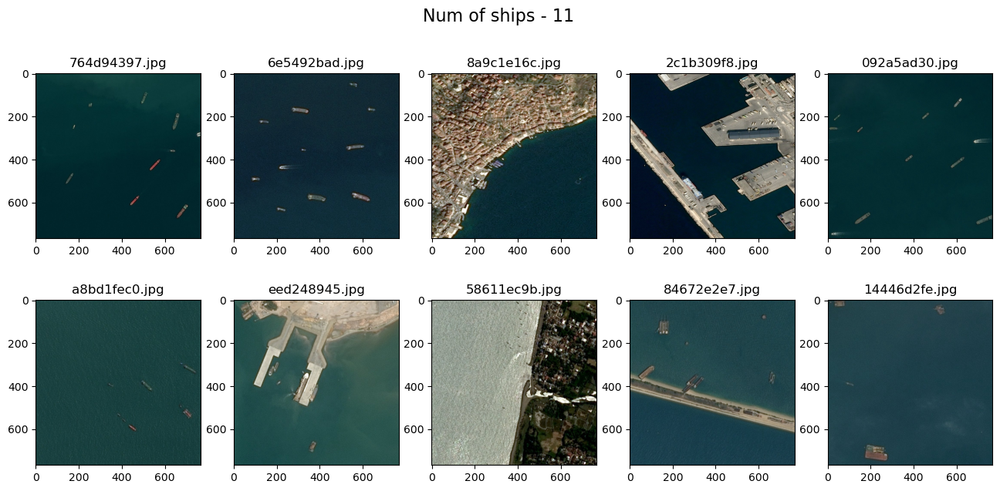

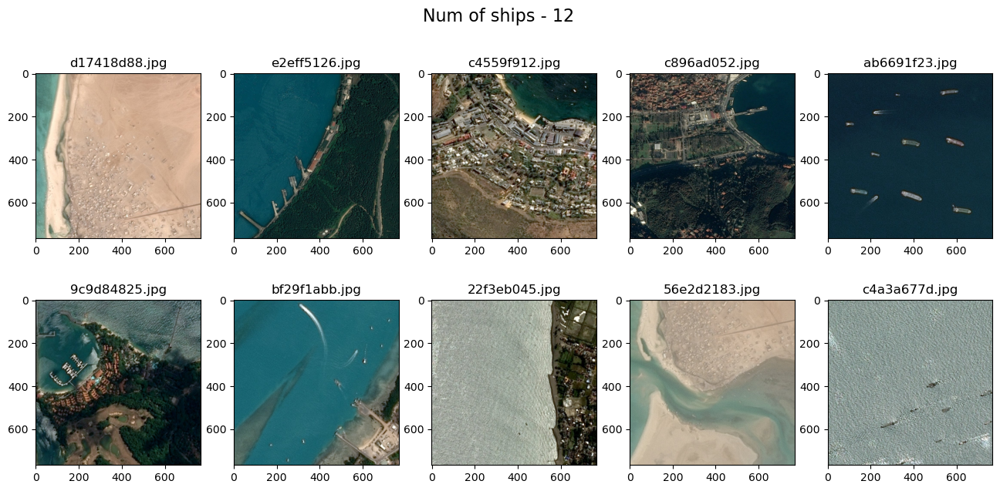

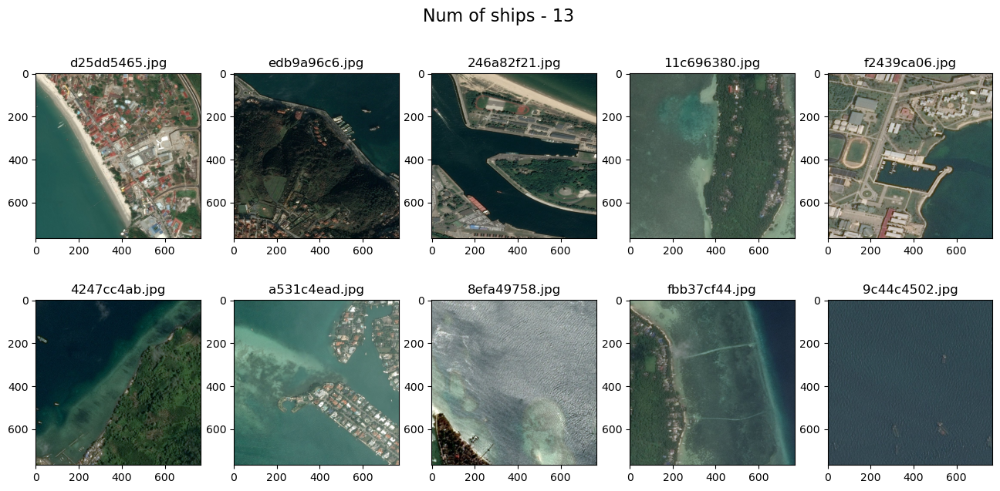

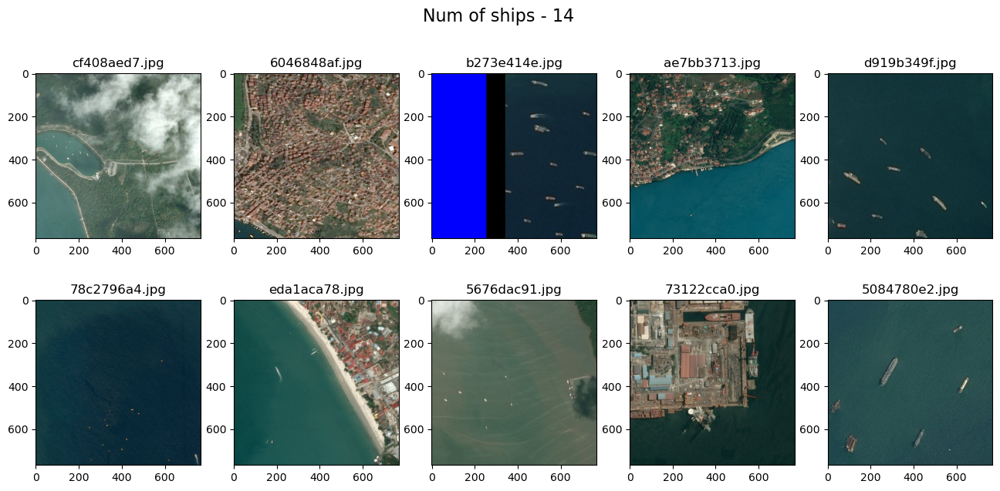

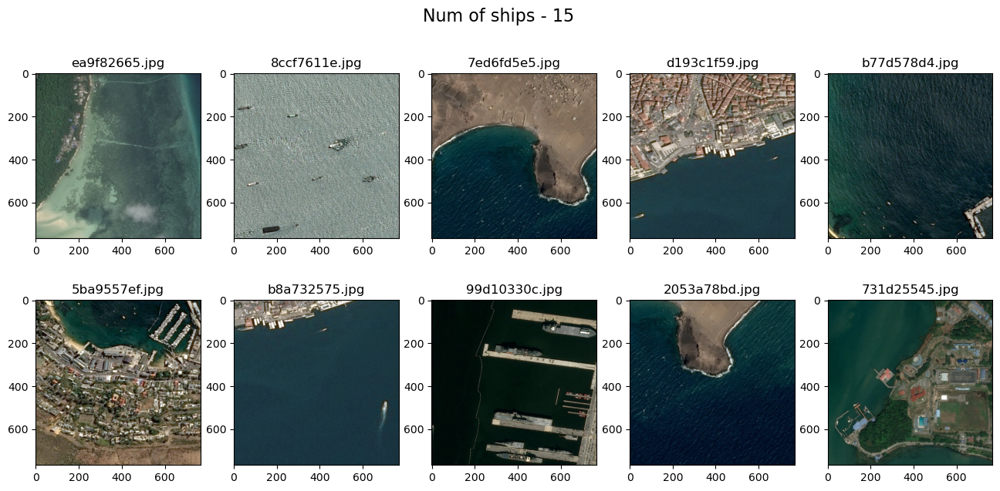

In [8]:
#some plots
random.seed(RANDOM_SEED)

for n_ships in range(16):

    #images with no ships
    temp = num_of_ships[num_of_ships['Num_of_ships']==n_ships]['ImageId'].values
    random.shuffle(temp)

    fig, axs = plt.subplots(2,5)
    fig.suptitle(f'Num of ships - {n_ships}', fontsize=16)
    for i in range(10):
        img = plt.imread(os.path.join(TRAIN_FOLDER, temp[i]))
        axs[i//5, i%5].imshow(img)
        axs[i//5, i%5].set_title(temp[i])

    plt.show()
    

In [9]:
#defs for decode and encode our masks of ships (Yeap, i took it from kaggle)

def rle_encode(img):
    '''
    img: numpy array, 1 - mask, 0 - background
    Returns run length as string formated
    '''
    pixels = img.T.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)

def rle_decode(mask_rle, shape=(768, 768)):
    '''
    mask_rle: run-length as string formated (start length)
    shape: (height,width) of array to return 
    Returns numpy array, 1 - mask, 0 - background
    '''
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape).T  # Needed to align to RLE direction

def masks_as_image(in_mask_list):
    # Take the individual ship masks and create a single mask array for all ships
    all_masks = np.zeros((768, 768), dtype = np.int16)
    #if isinstance(in_mask_list, list):
    for mask in in_mask_list:
        if isinstance(mask, str):
            all_masks += rle_decode(mask)
    return np.expand_dims(all_masks, -1)

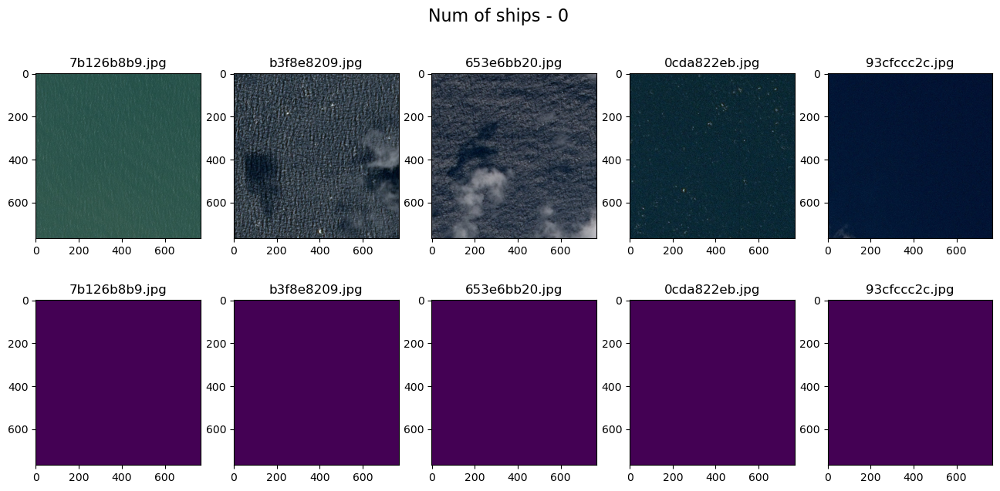

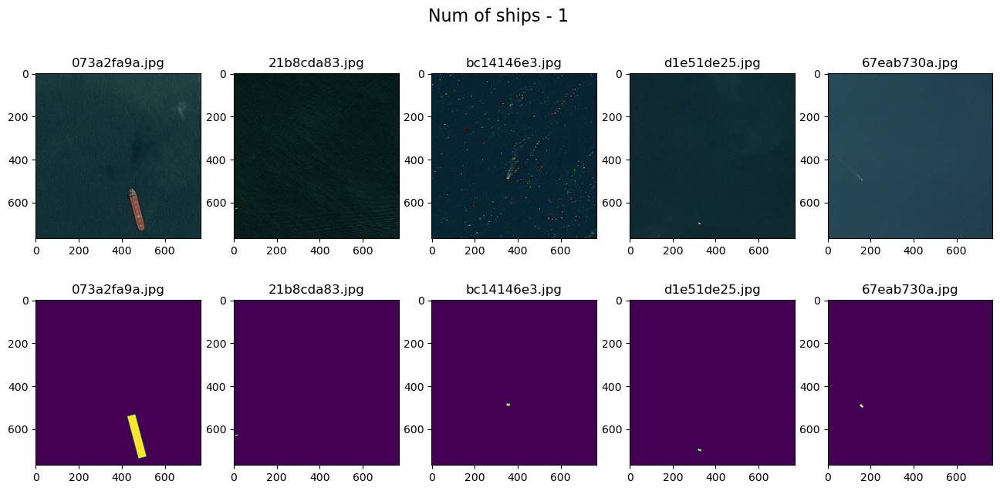

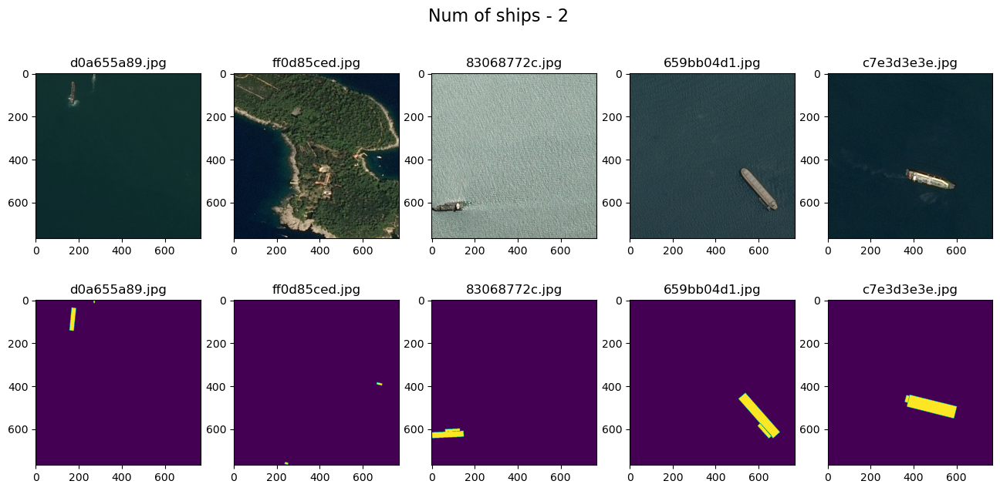

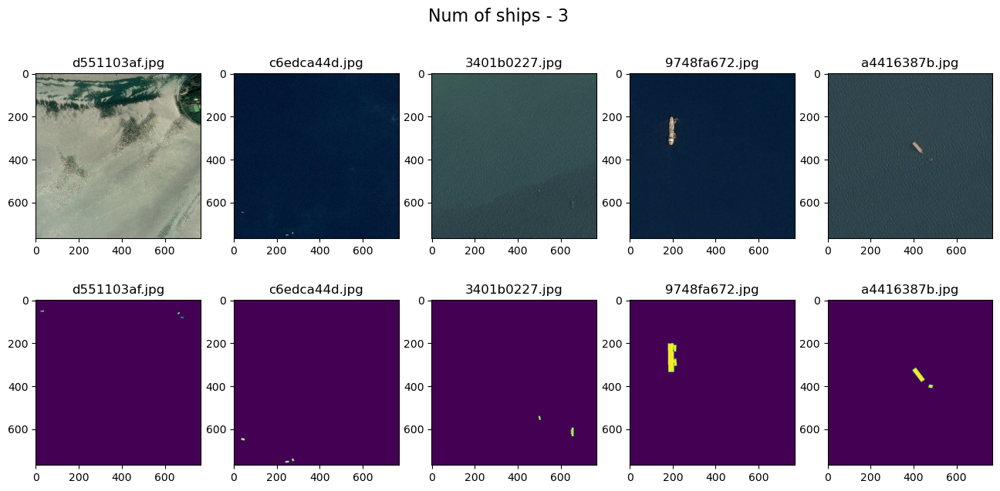

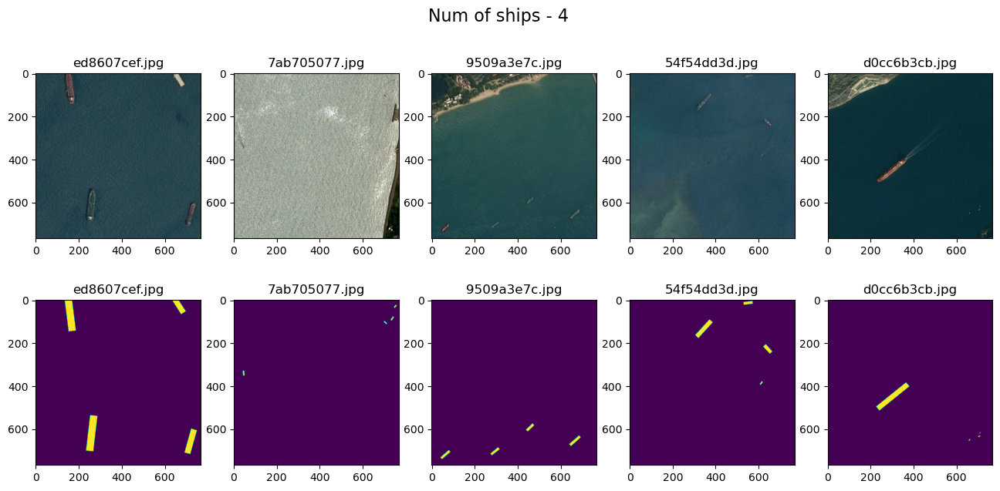

...

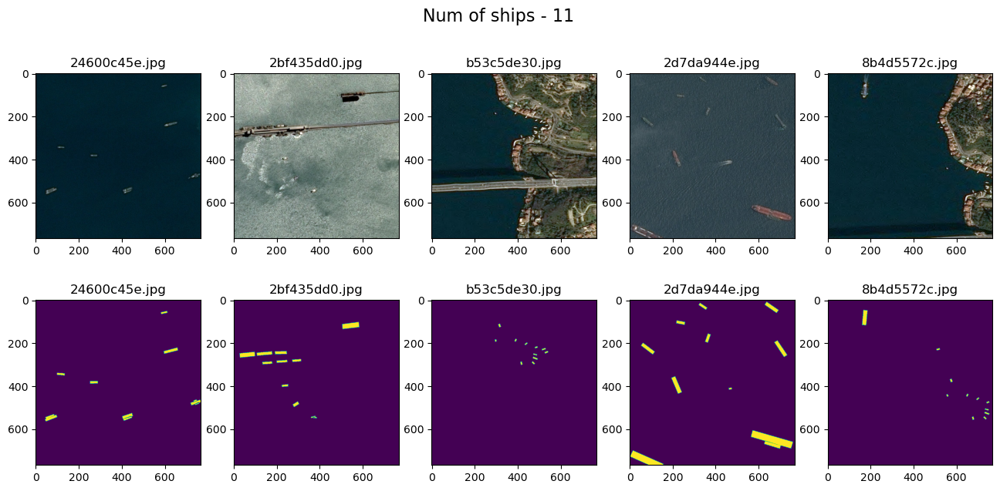

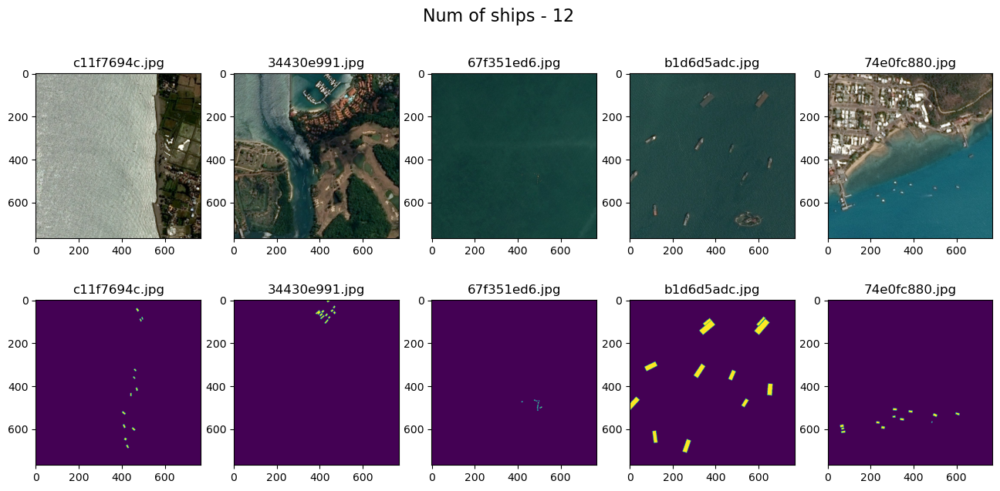

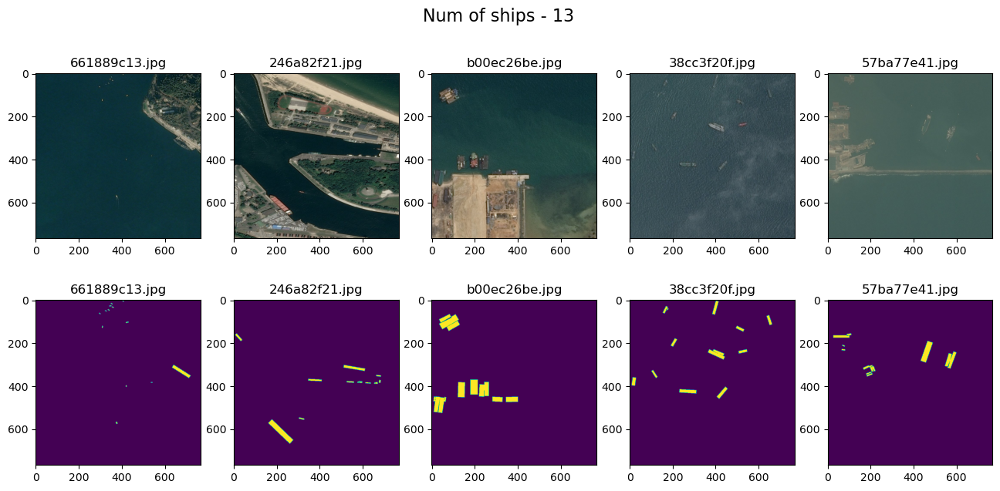

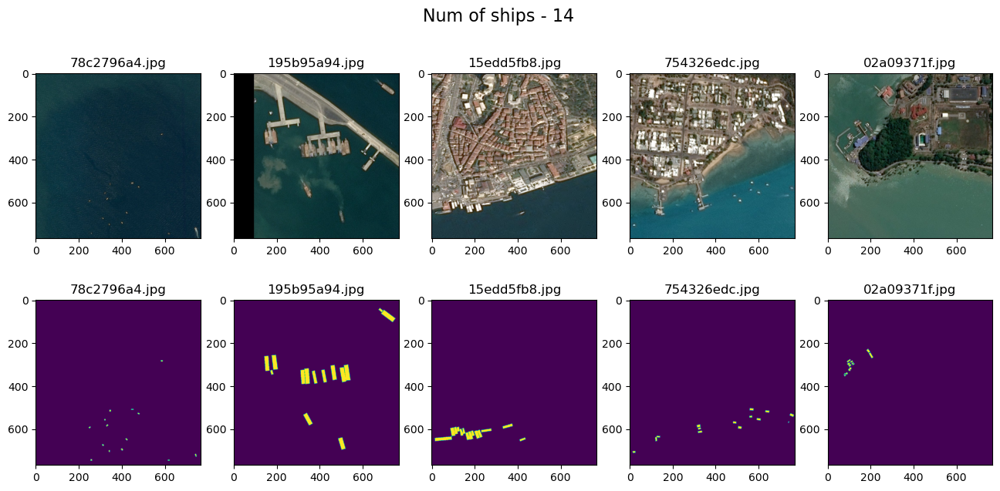

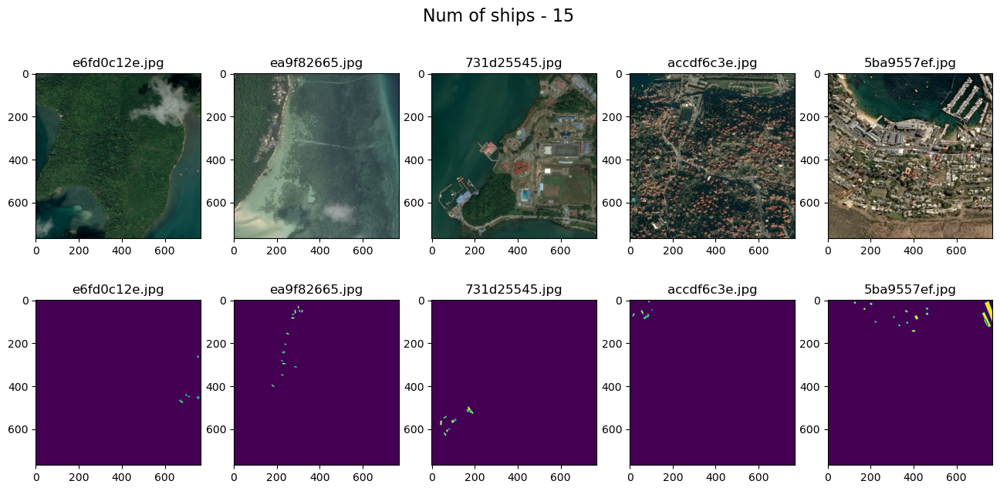

In [10]:
#some plots
random.seed(0)

for n_ships in range(16):

    #images with no ships
    temp = num_of_ships[num_of_ships['Num_of_ships']==n_ships]['ImageId'].values
    random.shuffle(temp)

    fig, axs = plt.subplots(2,5)
    fig.suptitle(f'Num of ships - {n_ships}', fontsize=16)
    for i in range(5):
        img = plt.imread(os.path.join(TRAIN_FOLDER, temp[i]))
        axs[0, i].imshow(img)
        axs[0, i].set_title(temp[i])
        
        mask = masks_as_image(df[df['ImageId']==temp[i]]['EncodedPixels'])
        axs[1, i].imshow(mask)
        axs[1, i].set_title(temp[i])

    plt.show()
    

# Images with no target

In [14]:
#select images with no target
imgs_0 = num_of_ships[num_of_ships['Num_of_ships']==0].copy().reset_index(drop=True)

In [15]:
#count mean value of all channels(RGB)
channels_mean = []
#count mean value of red channel
r_channel_mean = []
#count mean value of green channel
g_channel_mean = []
#count mean value of blue channel
b_channel_mean = []

for img_name in imgs_0['ImageId'].values:
    
    try:
        img = imread(os.path.join(TRAIN_FOLDER, img_name))
        
        channels_mean.append(np.mean(img))
        r_channel_mean.append(np.mean(img[:, :, 0]))
        g_channel_mean.append(np.mean(img[:, :, 1]))
        b_channel_mean.append(np.mean(img[:, :, 2]))
    except:
        channels_mean.append(np.nan)
        r_channel_mean.append(np.nan)
        g_channel_mean.append(np.nan)
        b_channel_mean.append(np.nan)
        
        

In [17]:
imgs_0['channels_mean'] = channels_mean
imgs_0['r_channel_mean'] = r_channel_mean
imgs_0['g_channel_mean'] = g_channel_mean
imgs_0['b_channel_mean'] = b_channel_mean

In [20]:
#round mean values 
imgs_0 = imgs_0.copy().round()

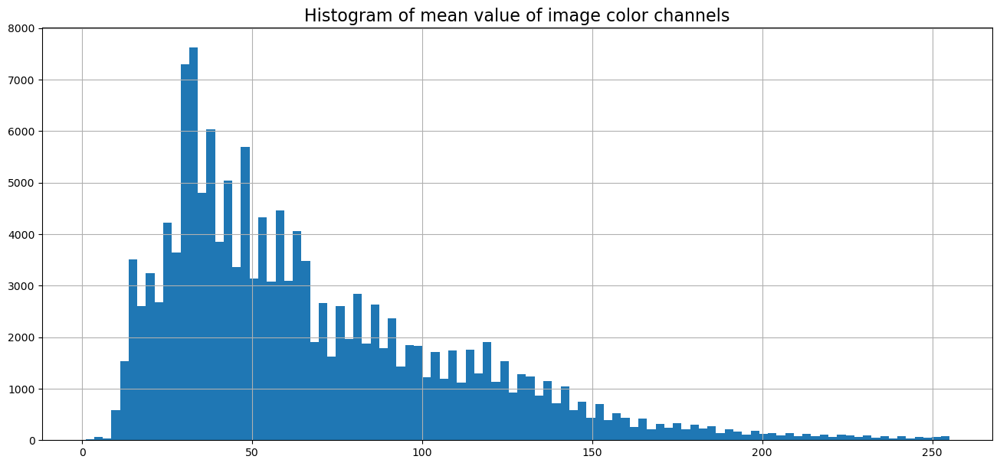

In [50]:
#hist of mean of channels
plt.title('Histogram of mean value of image color channels', fontsize=16)
imgs_0['channels_mean'].hist(bins=100)
plt.show()

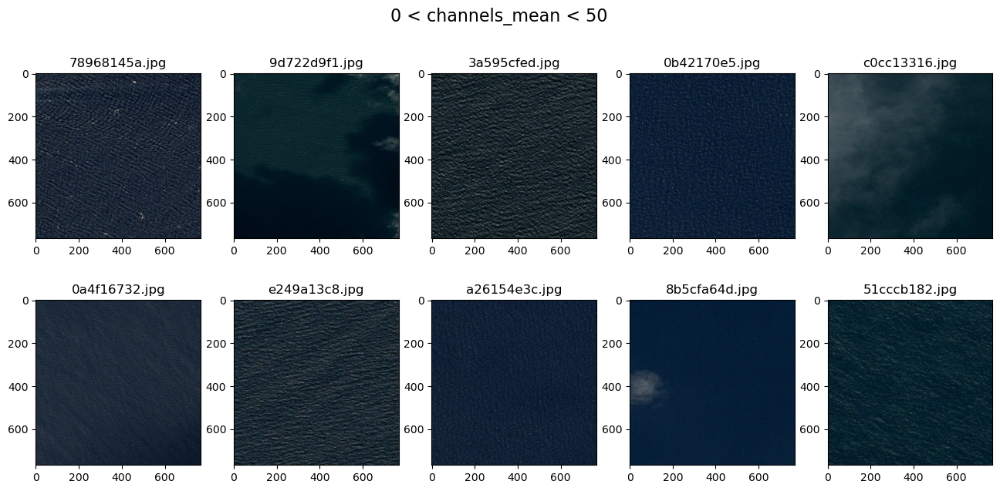

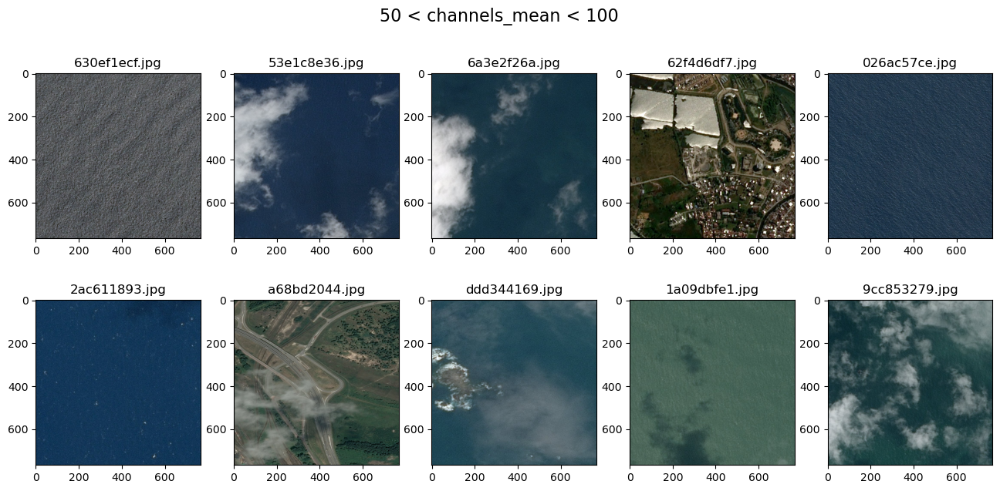

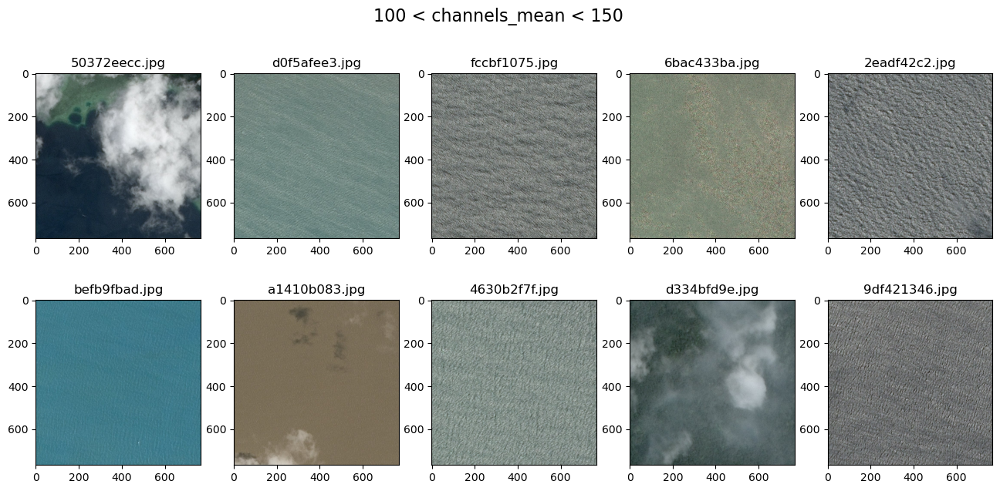

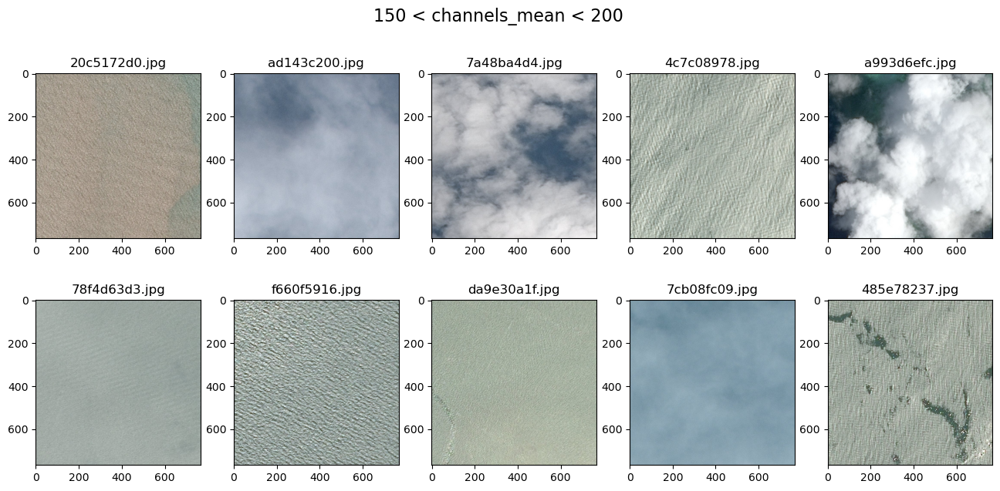

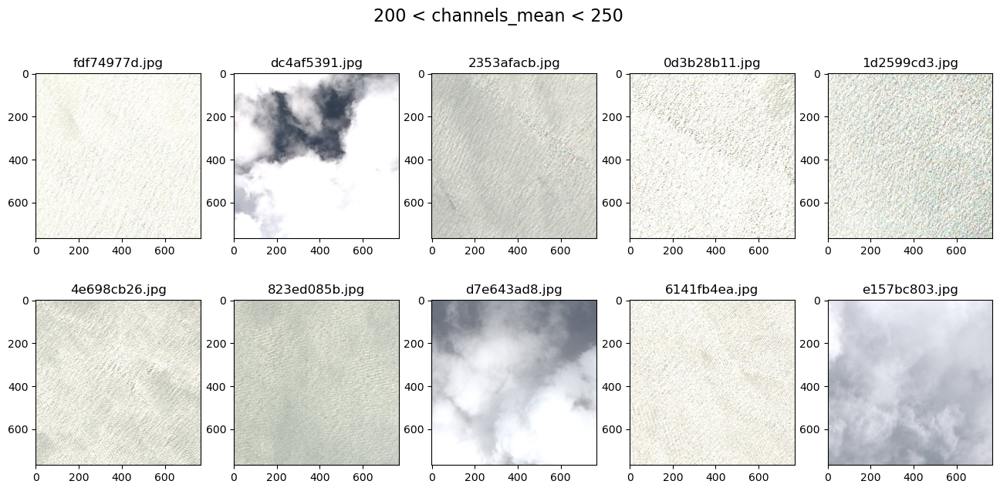

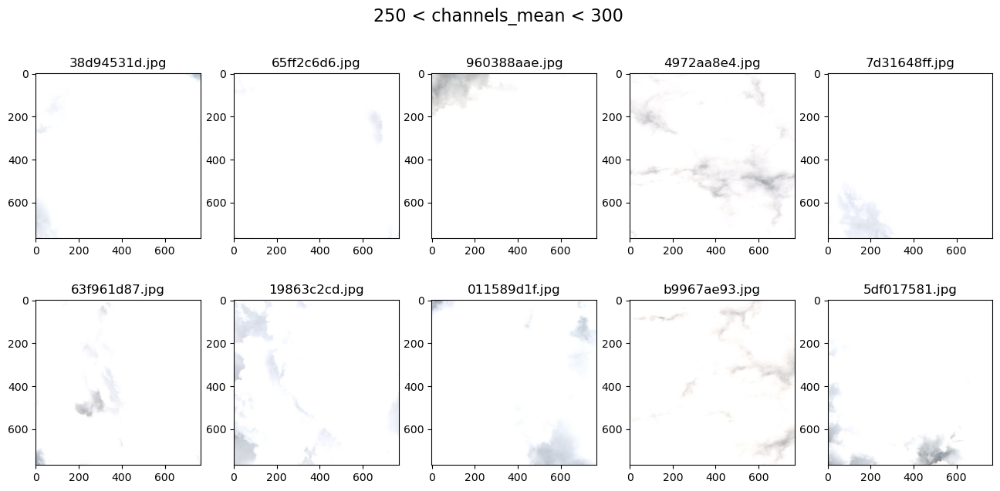

In [51]:
#some plots
random.seed(RANDOM_SEED)

for j in range(6):

    #images with no ships
    temp = imgs_0[(imgs_0['channels_mean']>j*50)&(imgs_0['channels_mean']<(j+1)*50)]['ImageId'].values
    random.shuffle(temp)

    fig, axs = plt.subplots(2,5)
    fig.suptitle(f'{(j)*50} < channels_mean < {(j+1)*50}', fontsize=16)
    for i in range(10):
        img = plt.imread(os.path.join(TRAIN_FOLDER, temp[i]))
        axs[i//5, i%5].imshow(img)
        axs[i//5, i%5].set_title(temp[i])

    plt.show()

So let us undersample images with stratifying by color channels mean
***